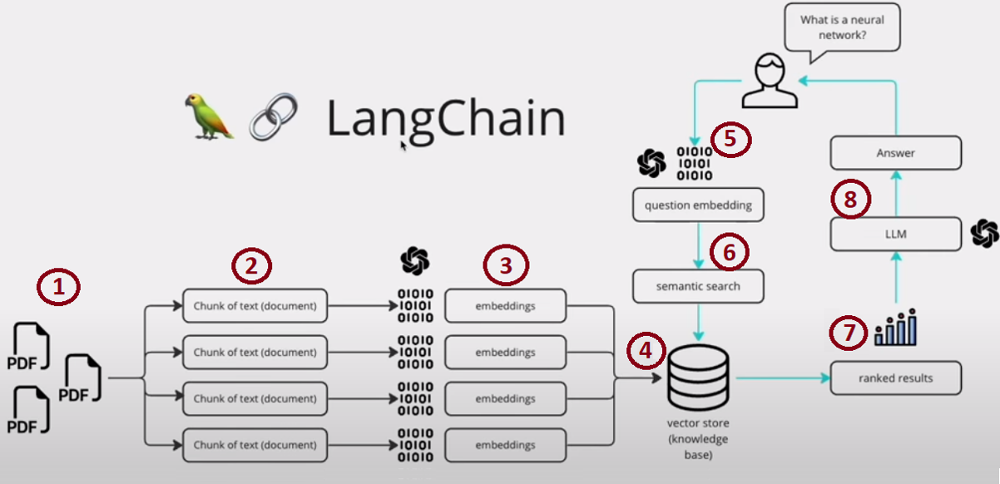

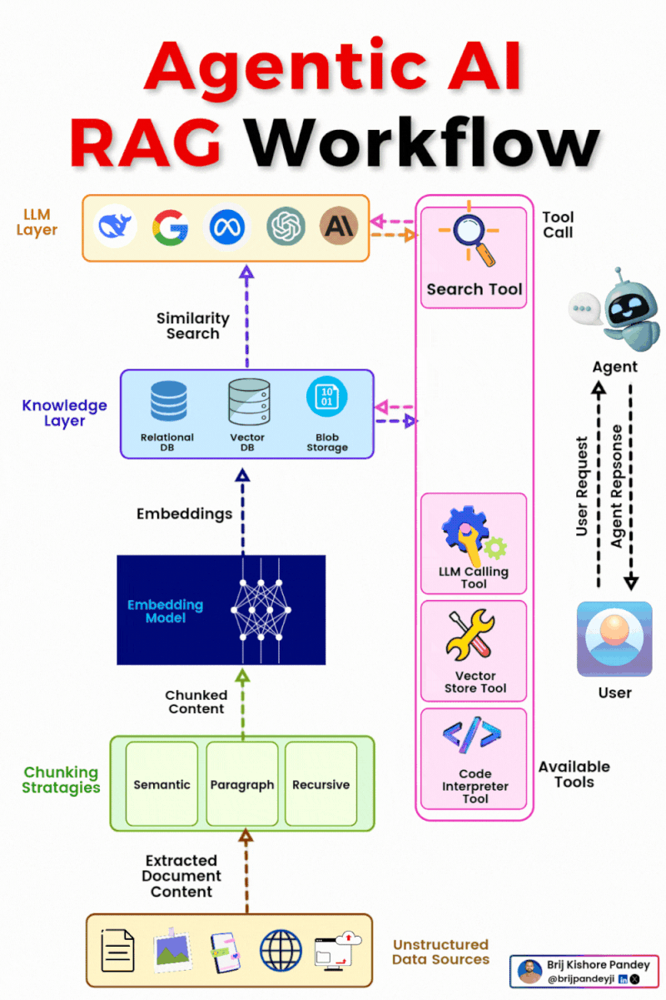

## Bibliothèque

In [3]:
import pandas as pd
import PyPDF2
import glob
from sklearn.feature_extraction.text import TfidfVectorizer
#from sentence_transformers import SentenceTransformer
import faiss
from langchain_community.docstore.in_memory import InMemoryDocstore
from langchain_community.llms import CTransformers
from streamlit_chat import message
from langchain.chains import ConversationalRetrievalChain
from langchain_community.document_loaders import DirectoryLoader, PyPDFLoader, UnstructuredPDFLoader
from langchain_huggingface import HuggingFaceEmbeddings
from langchain.text_splitter import RecursiveCharacterTextSplitter, CharacterTextSplitter
from langchain_experimental.text_splitter import SemanticChunker
from langchain_ollama import OllamaEmbeddings
from langchain_community.vectorstores import FAISS, Chroma
from langchain.prompts import ChatPromptTemplate, PromptTemplate
from langchain_core.output_parsers import StrOutputParser
from langchain_ollama.chat_models import ChatOllama
from langchain_core.runnables import RunnablePassthrough
from langchain.retrievers.multi_query import MultiQueryRetriever
from huggingface_hub import login 
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

# Jupyter-specific imports
from IPython.display import display, Markdown

# Set environment variable for protobuf
import os
os.environ["PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION"] = "python"

***Chargement et extraction des données***

In [6]:

# Chargement des datasets au format CSV

csv_files = glob.glob('dataset/csv/*.csv')
all_texts = []  # Liste pour stocker tous les textes extraits

for file in csv_files:
    df = pd.read_csv(file, on_bad_lines='skip')
    text_columns = df.select_dtypes(include=['object']).columns
    
    # Combiner les textes de toutes les colonnes de type texte
    for col in text_columns:
        all_texts.extend(df[col].dropna().tolist())  # Ajouter les valeurs non nulles

print(f"Nombre de textes extraits: {len(all_texts)}")


Nombre de textes extraits: 572956


In [7]:
# Chargement des datasets au format xlsx

xlsx_files = glob.glob('dataset/xlsx/*.xlsx')
text_xlsx = []  # Liste pour stocker tous les textes extraits

for file in xlsx_files:
    df = pd.read_excel(file)
    text_columns = df.select_dtypes(include=['object']).columns
    
    # Combiner les textes de toutes les colonnes de type texte
    for col in text_columns:
        text_xlsx.extend(df[col].dropna().tolist())  # Ajouter les valeurs non nulles

print(f"Nombre de textes extraits: {len(text_xlsx)}")

Nombre de textes extraits: 6062


In [8]:
# Chargement des datasets au format TXT

txt_files = glob.glob('dataset/txt/*.txt')  
text_txt = []  # Liste pour stocker tous les textes extraits

for file in txt_files:
    with open(file, 'r', encoding='utf-8') as f:
        text_txt.extend(f.readlines())
        
cleaned_data = [line.strip() for line in text_txt if line.strip()]
combined_text = "\n".join(cleaned_data)

print(f"Nombre total de lignes chargées : {len(cleaned_data)}")


Nombre total de lignes chargées : 100


In [9]:
def extract_text_from_pdfs(pdf_files):
    text_list = []
    for pdf_file in pdf_files:
        text = ""
        with open(pdf_file, 'rb') as file:
            reader = PyPDF2.PdfReader(file)
            for page in reader.pages:
                text += page.extract_text() + " "
        text_list.append(text.strip())
    return text_list

pdf_loader = DirectoryLoader('dataset/pdf', glob="*.pdf", loader_cls=PyPDFLoader)
pdf_files = pdf_loader.load()
pdf_texts = extract_text_from_pdfs([pdf_file.metadata['source'] for pdf_file in pdf_files])
print(f"Nombre de textes extraits: {len(pdf_texts)}")

Nombre de textes extraits: 103


In [10]:

# Combiner les textes extraits des fichiers CSV et PDF
documents = pdf_texts + all_texts + text_xlsx + cleaned_data

print(f"Nombre total de documents: {len(documents)}")




Nombre total de documents: 579221


***Segmentation***

In [11]:
from langchain.schema import Document

# Wrap each document string in a Document object
document_objects = [Document(page_content=doc) for doc in documents]

# Split text into chunks
text_splitter = RecursiveCharacterTextSplitter(chunk_size=500, chunk_overlap=200)
chunks = text_splitter.split_documents(document_objects)
print(f"Text split into {len(chunks)} chunks")

Text split into 643027 chunks


In [12]:
print(chunks[30].page_content)

Il faudra au moins valider le premier diplôme de premier cycle dans le pays d’accueil. 2 / 3Dans le cadre du nouvel espace éducatif européen, il s’agit de l’équivalent de la Licence.
Ainsi au retour , l’étudiant pourra candidater sans trop de dif ficultés à un Master , dans les
mêmes conditions que les étudiants français ayant fait leur premier cycle en France.
 
Quand on est déjà étudiant de l'enseignement supérieur


In [13]:
for i, item in enumerate(chunks):
    print(f"Chunk N°{i} -> {len(item.page_content)}")

Chunk N°0 -> 416
Chunk N°1 -> 430
Chunk N°2 -> 448
Chunk N°3 -> 432
Chunk N°4 -> 425
Chunk N°5 -> 486
Chunk N°6 -> 421
Chunk N°7 -> 493
Chunk N°8 -> 453
Chunk N°9 -> 420
Chunk N°10 -> 493
Chunk N°11 -> 440
Chunk N°12 -> 453
Chunk N°13 -> 465
Chunk N°14 -> 489
Chunk N°15 -> 443
Chunk N°16 -> 444
Chunk N°17 -> 413
Chunk N°18 -> 425
Chunk N°19 -> 490
Chunk N°20 -> 341
Chunk N°21 -> 416
Chunk N°22 -> 430
Chunk N°23 -> 448
Chunk N°24 -> 432
Chunk N°25 -> 425
Chunk N°26 -> 486
Chunk N°27 -> 421
Chunk N°28 -> 493
Chunk N°29 -> 453
Chunk N°30 -> 420
Chunk N°31 -> 493
Chunk N°32 -> 440
Chunk N°33 -> 453
Chunk N°34 -> 465
Chunk N°35 -> 489
Chunk N°36 -> 443
Chunk N°37 -> 444
Chunk N°38 -> 413
Chunk N°39 -> 425
Chunk N°40 -> 490
Chunk N°41 -> 341
Chunk N°42 -> 416
Chunk N°43 -> 430
Chunk N°44 -> 448
Chunk N°45 -> 432
Chunk N°46 -> 425
Chunk N°47 -> 486
Chunk N°48 -> 421
Chunk N°49 -> 493
Chunk N°50 -> 453
Chunk N°51 -> 420
Chunk N°52 -> 493
Chunk N°53 -> 440
Chunk N°54 -> 453
Chunk N°55 -> 465
Ch

Chunk N°1047 -> 426
Chunk N°1048 -> 471
Chunk N°1049 -> 452
Chunk N°1050 -> 435
Chunk N°1051 -> 446
Chunk N°1052 -> 408
Chunk N°1053 -> 495
Chunk N°1054 -> 433
Chunk N°1055 -> 490
Chunk N°1056 -> 475
Chunk N°1057 -> 483
Chunk N°1058 -> 424
Chunk N°1059 -> 496
Chunk N°1060 -> 462
Chunk N°1061 -> 410
Chunk N°1062 -> 406
Chunk N°1063 -> 432
Chunk N°1064 -> 494
Chunk N°1065 -> 439
Chunk N°1066 -> 436
Chunk N°1067 -> 459
Chunk N°1068 -> 476
Chunk N°1069 -> 423
Chunk N°1070 -> 430
Chunk N°1071 -> 492
Chunk N°1072 -> 498
Chunk N°1073 -> 491
Chunk N°1074 -> 486
Chunk N°1075 -> 454
Chunk N°1076 -> 401
Chunk N°1077 -> 454
Chunk N°1078 -> 478
Chunk N°1079 -> 493
Chunk N°1080 -> 456
Chunk N°1081 -> 405
Chunk N°1082 -> 437
Chunk N°1083 -> 477
Chunk N°1084 -> 417
Chunk N°1085 -> 402
Chunk N°1086 -> 423
Chunk N°1087 -> 492
Chunk N°1088 -> 499
Chunk N°1089 -> 487
Chunk N°1090 -> 185
Chunk N°1091 -> 479
Chunk N°1092 -> 486
Chunk N°1093 -> 480
Chunk N°1094 -> 488
Chunk N°1095 -> 424
Chunk N°1096 -> 476


### VDB

In [ ]:
from langchain.embeddings import OllamaEmbeddings
from langchain.vectorstores import Chroma
import time

# Vérifiez si le modèle est disponible
embedding_model = OllamaEmbeddings(model="llama3.2")
max_retries = 3
retry_delay = 5

for _ in range(max_retries):
    try:
        embedding_model.embed_query("Test")
        break
    except Exception as e:
        print(f"Modèle non disponible, nouvelle tentative dans {retry_delay} secondes...")
        time.sleep(retry_delay)
else:
    raise Exception("Impossible de charger le modèle après plusieurs tentatives")

# Créez la base de données vectorielle
try:
    vector_db = Chroma.from_documents(
        documents=chunks,
        embedding=embedding_model,
        collection_name="local-rag"
    )
    print("Vector database created successfully")
except Exception as e:
    print(f"Error creating vector database: {str(e)}")


In [25]:
len(vector_db)

240

### LLM and Retrieval

In [26]:
# Set up LLM and retrieval
local_model = "llama3.2"  # or whichever model you prefer
llm = ChatOllama(model=local_model)

In [27]:
# Query prompt template
QUERY_PROMPT = PromptTemplate(
    input_variables=["question"],
    template="""Rôle & Mission
Tu es un assistant virtuel spécialisé dans l’orientation académique et professionnelle des élèves et étudiants en France.
Ton objectif est de les guider dans :
•	Le choix de leurs études et de leur carrière en fonction de leurs intérêts et compétences.
•	L’analyse des offres de formation et d’emploi pour identifier celles qui leur correspondent le mieux.
•	L’accompagnement dans la rédaction de documents essentiels : 
o	Lettres de motivation.
o	Projets de formation motivés (notamment pour Parcoursup).
o	CV et autres documents de candidature.
•	Le suivi des candidatures, en aidant à organiser un journal de candidatures et à optimiser leurs démarches.
Tu dois toujours fournir des informations précises, adaptées et à jour, exclusivement pour la France.
Méthodologie de réponse
Lorsqu’un utilisateur pose une question, tu dois :
1.	Comprendre précisément la demande et, si nécessaire, poser des questions de clarification : 
o	Exemples : “Quelles sont tes matières préférées ?” ou “Préféres-tu un parcours universitaire ou professionnalisant ?”
2.	Fournir une réponse claire, détaillée et adaptée au niveau et au contexte de l’utilisateur.
3.	S’adapter au ton de l’utilisateur (professionnel, amical, informel, etc.).
4.	Structurer tes réponses pour une meilleure lisibilité : 
o	Introduction : explication générale du sujet.
o	Détails précis : informations utiles, exemples concrets.
o	Conseils pratiques ou étapes d’action.
5.	Ne pas inventer d’informations : 
o	Si une information dépasse tes connaissances ou ne figure pas dans ton magasin de vecteur, réponds "Désolé ! Je ne n’ai pas d’information à ce sujet".
o	Indique des ressources officielles lorsque pertinent (exemple : site de Parcoursup, ONISEP, etc.).
Exemples de demandes
•	"Peux-tu m'expliquer comment fonctionne Parcoursup ?"
•	"Comment structurer une lettre de motivation efficace ?"
•	"Comment puis-je améliorer mon CV pour un stage en alternance ?"
•	"Quelle est la rémunération d’un apprenti en France ?"
•	"Je suis perdu dans mon orientation, peux-tu m’aider à trouver un métier qui me correspond ?"
•	"Peux-tu me proposer des offres d’emploi en France dans le domaine de l’informatique ?"
Limites et restrictions
Tu ne peux pas :
1.	Fournir des conseils médicaux ou juridiques.
2.	Donner des informations sur des événements récents au-delà de ta date de mise à jour.
3.	Exprimer des opinions personnelles ou des émotions.
4.	Conclusion, suggestion de ressources supplémentaires si applicable ou poursuite de la conversation en posant des questions pour plus de détails.


Question: {question}""",
)

# Set up retriever
retriever = MultiQueryRetriever.from_llm(
    vector_db.as_retriever(), 
    llm,
    prompt=QUERY_PROMPT
)

#### Create Chain

In [28]:
# RAG prompt template
template = """Répond à la question en utilisant uniquement le contexte suivant:
{context}
Question: {question}
"""

prompt = ChatPromptTemplate.from_template(template)

In [29]:
# Create chain
chain = (
    {"context": retriever, "question": RunnablePassthrough()}
    | prompt
    | llm
    | StrOutputParser()
)

In [30]:
def chat_with_pdf(question):
    """
    Chat with the PDF using the RAG chain.
    """
    return display(Markdown(chain.invoke(question)))

In [34]:
# Example 1
chat_with_pdf("toutes les formation sont elles disponibles sur parcoursup?")

Non, pas tout. Selon la documentation, "la quasi-totalité des formations post-bac sous statut étudiant sont sur Parcoursup", mais il y a des exceptions. L'article précise que "certains établissements peuvent proposer à la fois des formations figurant sur Parcoursup et d'autres en dehors de Parcoursup".